In [1]:
from skimage.io import imread
import napari_simpleitk_image_processing as nsitk
import pyclesperanto_prototype as cle
import napari_pyclesperanto_assistant
import pandas
from napari_skimage_regionprops import regionprops_table, add_table, get_table
import napari
viewer = napari.Viewer()

In [3]:
image0_O1 = imread("D:\Datasets\Claudia Dagostino/Org797_1.tiff")
viewer.add_image(image0_O1, name="Org43_1")

<Image layer 'Org43_1' at 0x2768b3d3640>

## laplacian of gaussian filter

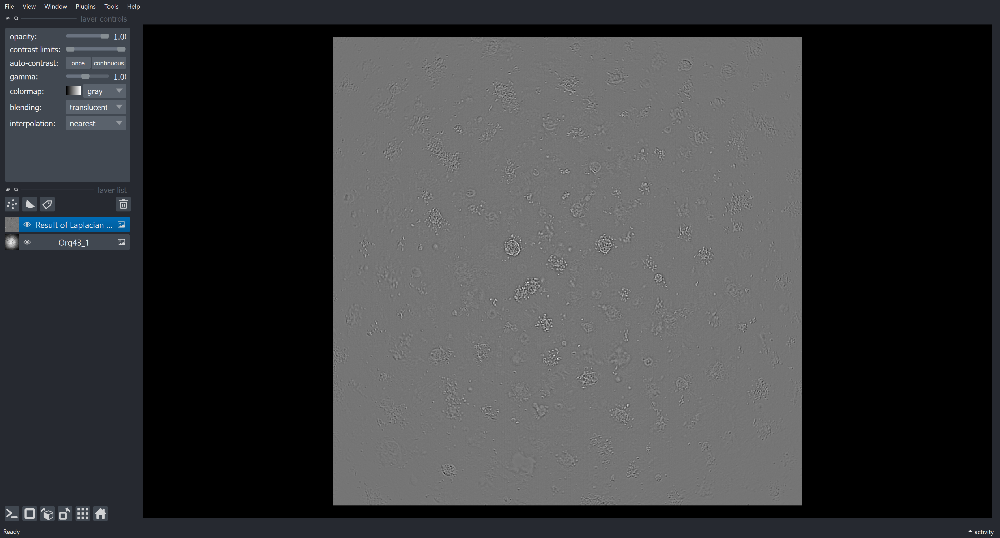

In [4]:
image1_L = nsitk.laplacian_of_gaussian_filter(image0_O1, 1.0)
viewer.add_image(
    image1_L, name='Result of Laplacian of Gaussian (n-SimpleITK)')
napari.utils.nbscreenshot(viewer)

## standard deviation filter

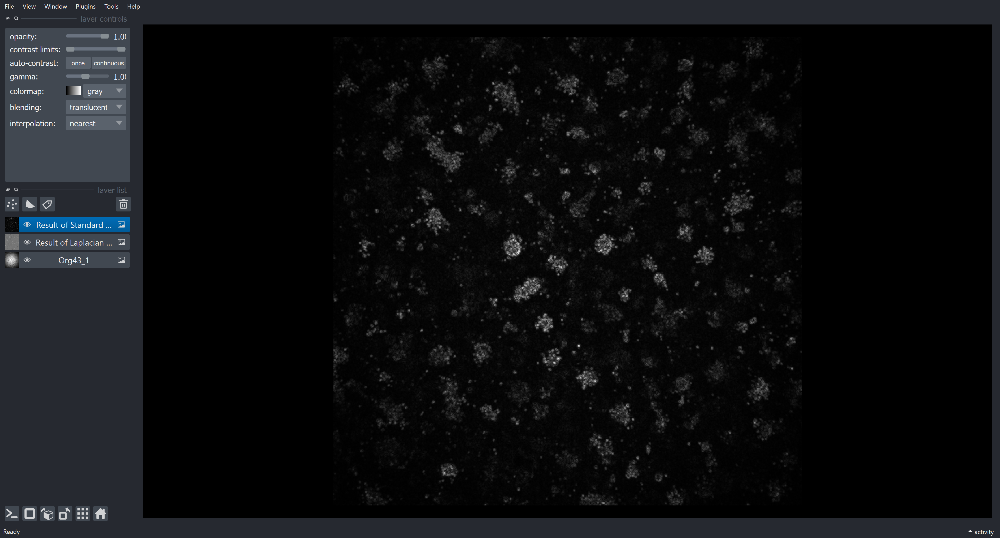

In [5]:
image2_S = nsitk.standard_deviation_filter(image1_L, 1, 1, 0)
viewer.add_image(
    image2_S, name='Result of Standard deviation filter (noise, n-SimpleITK)')
napari.utils.nbscreenshot(viewer)

## threshold otsu

INFO:pyopencl:build program: kernel 'copy_slice_to_3d' was part of a lengthy source build resulting from a binary cache miss (0.57 s)
INFO:pyopencl:build program: kernel 'greater_constant_2d' was part of a lengthy source build resulting from a binary cache miss (0.34 s)
INFO:pyopencl:build program: kernel 'range' was part of a lengthy source build resulting from a binary cache miss (0.35 s)


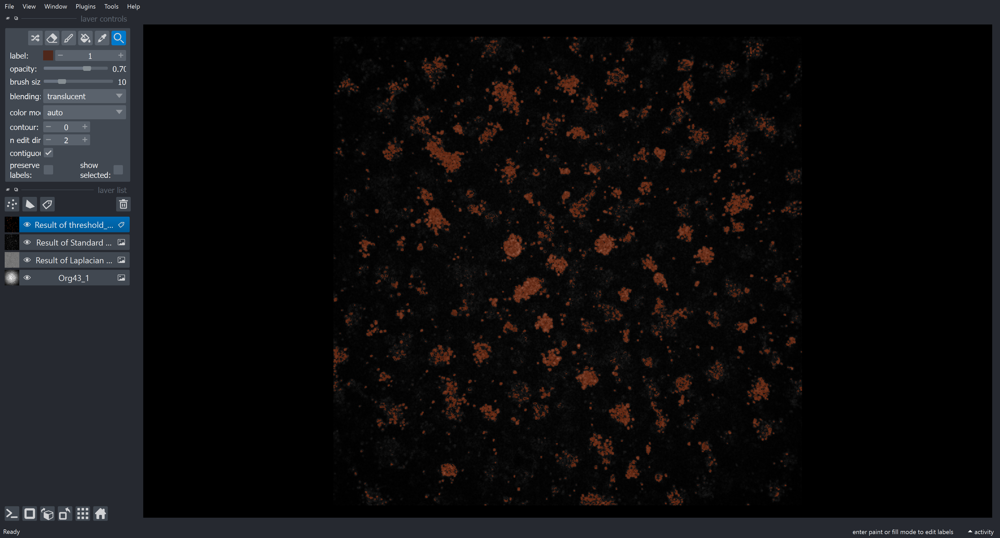

In [6]:
image3_to = cle.threshold_otsu(image2_S)
viewer.add_labels(image3_to, name='Result of threshold_otsu (clesperanto)')
napari.utils.nbscreenshot(viewer)

## closing labels

INFO:pyopencl:build program: kernel 'copy_2d' was part of a lengthy source build resulting from a binary cache miss (0.41 s)
INFO:pyopencl:build program: kernel 'onlyzero_overwrite_maximum_box_2d' was part of a lengthy source build resulting from a binary cache miss (0.37 s)
INFO:pyopencl:build program: kernel 'copy_2d' was part of a lengthy source build resulting from a binary cache miss (0.34 s)
INFO:pyopencl:build program: kernel 'greater_constant_2d' was part of a lengthy source build resulting from a binary cache miss (0.35 s)
INFO:pyopencl:build program: kernel 'erode_sphere_2d' was part of a lengthy source build resulting from a binary cache miss (0.36 s)
INFO:pyopencl:build program: kernel 'multiply_images_2d' was part of a lengthy source build resulting from a binary cache miss (0.35 s)
INFO:pyopencl:build program: kernel 'range' was part of a lengthy source build resulting from a binary cache miss (0.35 s)


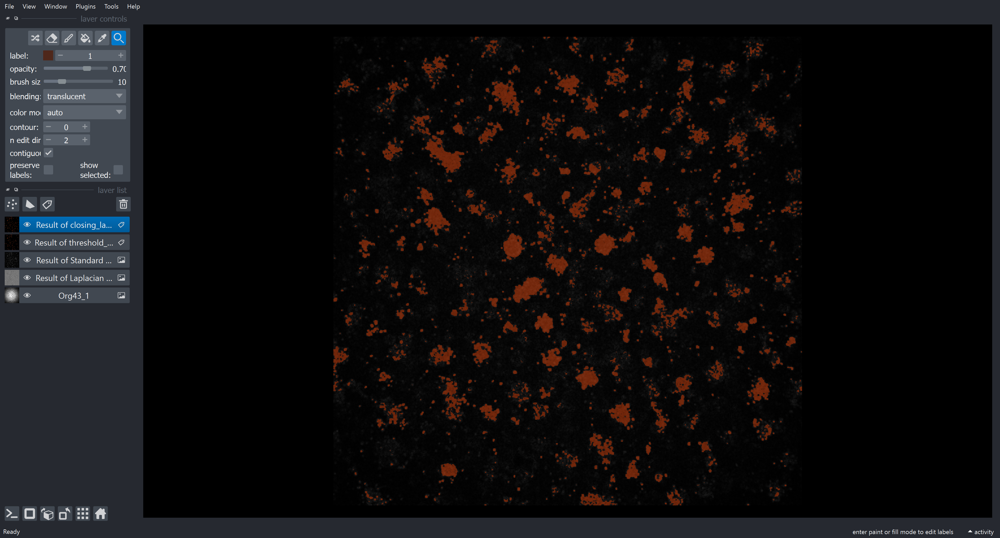

In [7]:
image4_cl = cle.closing_labels(image3_to, None, 1.0)
viewer.add_labels(image4_cl, name='Result of closing_labels (clesperanto)')
napari.utils.nbscreenshot(viewer)

## binary fill holes

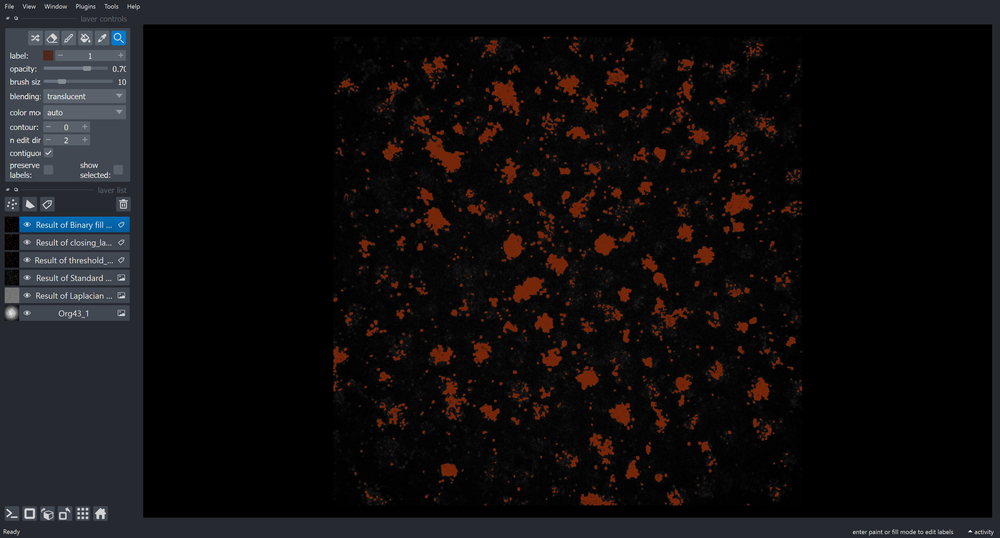

In [8]:
image5_B = nsitk.binary_fill_holes(image4_cl)
viewer.add_labels(image5_B, name='Result of Binary fill holes (n-SimpleITK)')
napari.utils.nbscreenshot(viewer)

## label

INFO:pyopencl:build program: kernel 'set_nonzero_pixels_to_pixelindex' was part of a lengthy source build resulting from a binary cache miss (0.42 s)
INFO:pyopencl:build program: kernel 'nonzero_minimum_box_2d' was part of a lengthy source build resulting from a binary cache miss (0.40 s)
INFO:pyopencl:build program: kernel 'flag_existing_labels' was part of a lengthy source build resulting from a binary cache miss (0.38 s)
INFO:pyopencl:build program: kernel 'replace_intensities' was part of a lengthy source build resulting from a binary cache miss (0.37 s)


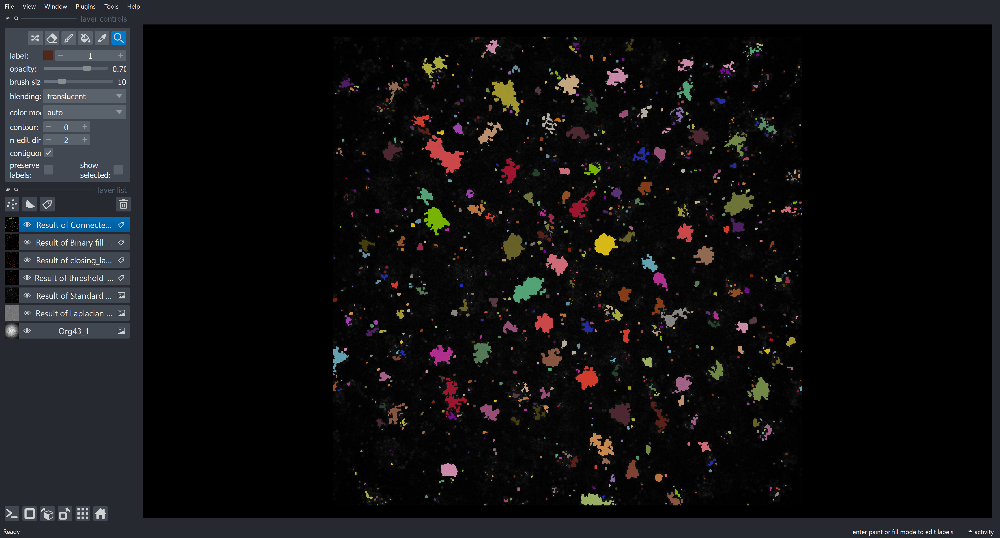

In [9]:
image6_C = cle.label(image5_B)
viewer.add_labels(
    image6_C, name='Result of Connected component labeling (clesperanto)')
napari.utils.nbscreenshot(viewer)

## exclude small labels

INFO:pyopencl:build program: kernel 'add_image_and_scalar_2d' was part of a lengthy source build resulting from a binary cache miss (0.41 s)
INFO:pyopencl:build program: kernel 'set_plane_3d' was part of a lengthy source build resulting from a binary cache miss (0.37 s)
INFO:pyopencl:build program: kernel 'statistics_per_label' was part of a lengthy source build resulting from a binary cache miss (0.45 s)
INFO:pyopencl:build program: kernel 'sum_y_projection' was part of a lengthy source build resulting from a binary cache miss (0.41 s)
INFO:pyopencl:build program: kernel 'minimum_y_projection' was part of a lengthy source build resulting from a binary cache miss (0.39 s)
INFO:pyopencl:build program: kernel 'maximum_y_projection' was part of a lengthy source build resulting from a binary cache miss (0.39 s)
INFO:pyopencl:build program: kernel 'crop_2d' was part of a lengthy source build resulting from a binary cache miss (0.39 s)
INFO:pyopencl:build program: kernel 'paste_3d' was part 

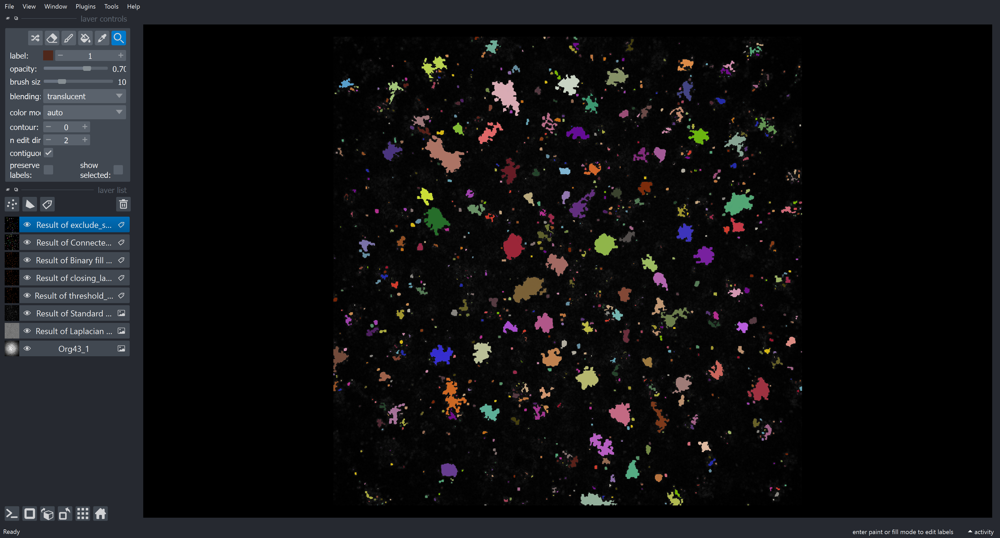

In [10]:
image7_esl = cle.exclude_small_labels(image6_C, None, 300.0)
viewer.add_labels(
    image7_esl, name='Result of exclude_small_labels (clesperanto)')
napari.utils.nbscreenshot(viewer)

## exclude labels on edges

INFO:pyopencl:build program: kernel 'maximum_y_projection' was part of a lengthy source build resulting from a binary cache miss (0.43 s)
INFO:pyopencl:build program: kernel 'exclude_on_edges_y_3d' was part of a lengthy source build resulting from a binary cache miss (0.39 s)
INFO:pyopencl:build program: kernel 'replace_intensities' was part of a lengthy source build resulting from a binary cache miss (0.38 s)


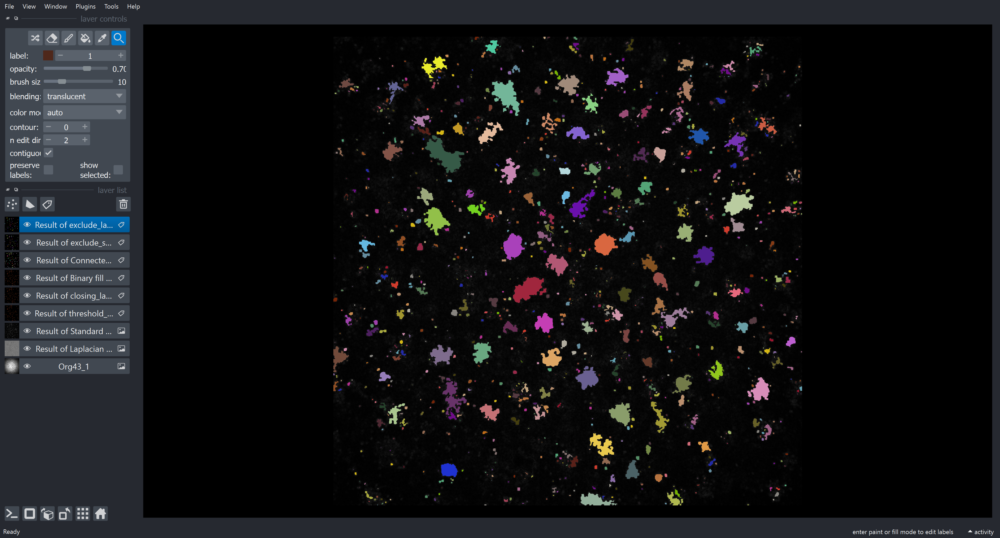

In [11]:
image8_eloe = cle.exclude_labels_on_edges(image7_esl)
viewer.add_labels(
    image8_eloe, name='Result of exclude_labels_on_edges (clesperanto)')
napari.utils.nbscreenshot(viewer)

In [12]:
regionprops_table(
    image0_O1,
    image8_eloe,
    size=True,
    intensity=False,
    napari_viewer=viewer,
)
table = pandas.DataFrame(get_table(viewer.layers[-1], viewer).get_content())
table

,label,area,bbox_area,convex_area,equivalent_diameter,index
0,1,345,748,488,20.958713,1
1,2,450,999,644,23.936537,2
2,3,356,594,432,21.290216,3
3,4,935,2070,1348,34.503318,4
4,5,520,1872,1107,25.731004,5
...,...,...,...,...,...,...
74,75,580,1056,766,27.174969,75
75,76,452,729,557,23.989670,76
76,77,1491,2754,1990,43.570634,77
77,78,546,1677,1073,26.366433,78
